In [69]:
import pandas as pd
import numpy as np
import xgboost as xgb
import dalex as dx
import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

mapbox_access_token = 'pk.'
px.set_mapbox_access_token(mapbox_access_token)

## Read training data for Brazil, Thailand and Philippines

In [70]:
data_phl = pd.read_csv('../data/training_sets/Philippines/training_set_v001.csv')
data_tha = pd.read_csv('../data/training_sets/Thailand/training_set_v001.csv')
data_bra = pd.read_csv('../data/training_sets/Brazil/training_set_v002.csv')

## Get predictors and target

In [71]:
dic = pd.read_excel('../data/meta/training_dict_bra.xlsx', engine='openpyxl')

In [72]:
predictors = dic.loc[(dic.role=='predictor') & (dic.use == 'Y'), 'name'].values.tolist()
target = dic.loc[dic.role=='target', 'name'].values.tolist()

In [73]:
predictors

['avg_d_kbps',
 'avg_u_kbps',
 'population',
 'mean_ghm',
 'mean_avg_rad',
 'slope_year_avg_rad',
 'slope_month_avg_rad',
 'mean_cf_cvg',
 'slope_month_cf_cvg',
 'mean_NDVI',
 'slope_year_NDVI',
 'estimate_mau']

In [74]:
x_phl = data_phl[predictors]
y_phl = data_phl[target]
x_bra = data_bra[predictors]
y_bra = data_bra[target]
x_tha = data_tha[predictors]
y_tha = data_tha[target]

## Initialize and Train the Champion Model on Brazil Data

In [75]:
model = xgb.XGBRegressor(random_state=42, n_estimators=550, max_depth=9, eta=.2, n_jobs=16)
model.fit(x_bra, y_bra)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eta=0.2, gamma=0,
             gpu_id=-1, importance_type='gain', interaction_constraints='',
             learning_rate=0.200000003, max_delta_step=0, max_depth=9,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=550, n_jobs=16, num_parallel_tree=1, random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

## Model Evaluation

In [76]:
exp_phl = dx.Explainer(model, x_phl, y_phl, label = 'xGradient Boosting Philippines')
exp_bra = dx.Explainer(model, x_bra, y_bra, label = 'xGradient Boosting Brazil')
exp_tha = dx.Explainer(model, x_tha, y_tha, label = 'xGradient Boosting Thailand')

Preparation of a new explainer is initiated

  -> data              : 4599 rows 12 cols
  -> target variable   : Parameter 'y' was a pandas.DataFrame. Converted to a numpy.ndarray.
  -> target variable   : 4599 values
  -> model_class       : xgboost.sklearn.XGBRegressor (default)
  -> label             : xGradient Boosting Philippines
  -> predict function  : <function yhat_default at 0x0000029D344FC168> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.132, mean = 0.608, max = 1.05
  -> model type        : regression will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.94, mean = -0.317, max = 0.591
  -> model_info        : package xgboost

A new explainer has been created!
Preparation of a new explainer is initiated

  -> data              : 11732 rows 12 cols
  -> target variable   : Parameter 'y' was a pandas.DataFrame. C

## Permutation Feature Importance for BRA, THA and PHL

In [77]:
mfe_bra = exp_bra.model_parts()
mfe_phl = exp_phl.model_parts()
mfe_tha = exp_tha.model_parts()

In [78]:
mfe_bra.plot()
mfe_tha.plot()
mfe_phl.plot()

## Residual Analysis for BRA vs. THA and PHL

In [79]:
md_bra = exp_bra.model_diagnostics()
md_phl = exp_phl.model_diagnostics()
md_tha = exp_tha.model_diagnostics()

In [80]:
md_bra.plot(md_tha)
md_bra.plot(md_phl)

In [81]:
mp_bra = exp_bra.model_performance(model_type='regression')
mp_phl = exp_phl.model_performance(model_type='regression')
mp_tha = exp_tha.model_performance(model_type='regression')

In [82]:
mp_bra.result

,mse,rmse,r2,mae,mad
xGradient Boosting Brazil,0.000012,0.003469,0.999706,0.002298,0.001433


In [83]:
mp_tha.result

,mse,rmse,r2,mae,mad
xGradient Boosting Thailand,0.050051,0.223722,-5.820398,0.17157,0.130898


In [84]:
mp_phl.result

,mse,rmse,r2,mae,mad
xGradient Boosting Philippines,0.167829,0.40967,-1.9023,0.354745,0.347575


In [85]:
mp_bra.plot(mp_tha)

In [86]:
mp_bra.plot(mp_phl)

## Calculate performance metrics as classification task by binning the target variable with threshold

In [87]:
ts = .3

tp_tha = len(mp_tha.residuals[(mp_tha.residuals.y_hat<=ts) & (mp_tha.residuals.y<=ts)])
tn_tha = len(mp_tha.residuals[(mp_tha.residuals.y_hat>ts) & (mp_tha.residuals.y>ts)])
fp_tha = len(mp_tha.residuals[(mp_tha.residuals.y_hat<=ts) & (mp_tha.residuals.y>ts)])
fn_tha = len(mp_tha.residuals[(mp_tha.residuals.y_hat>ts) & (mp_tha.residuals.y<=ts)])

tp_phl = len(mp_phl.residuals[(mp_phl.residuals.y_hat<=ts) & (mp_phl.residuals.y<=ts)])
tn_phl = len(mp_phl.residuals[(mp_phl.residuals.y_hat>ts) & (mp_phl.residuals.y>ts)])
fp_phl = len(mp_phl.residuals[(mp_phl.residuals.y_hat<=ts) & (mp_phl.residuals.y>ts)])
fn_phl = len(mp_phl.residuals[(mp_phl.residuals.y_hat>ts) & (mp_phl.residuals.y<=ts)])

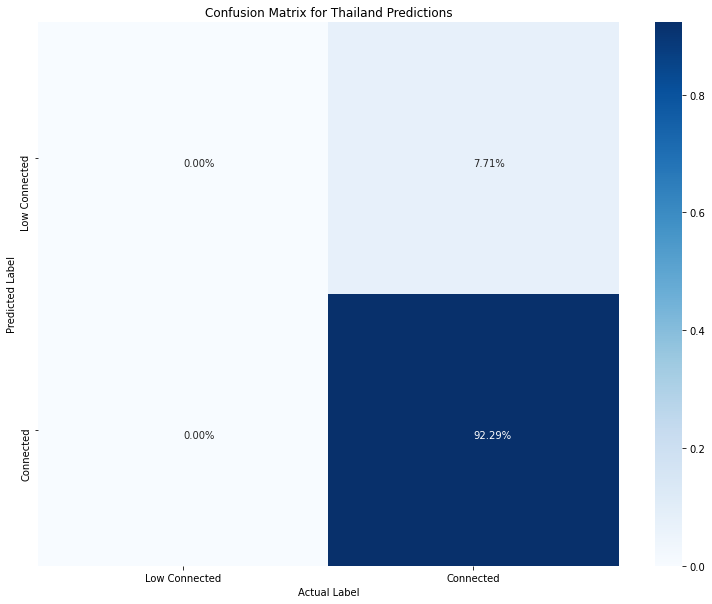

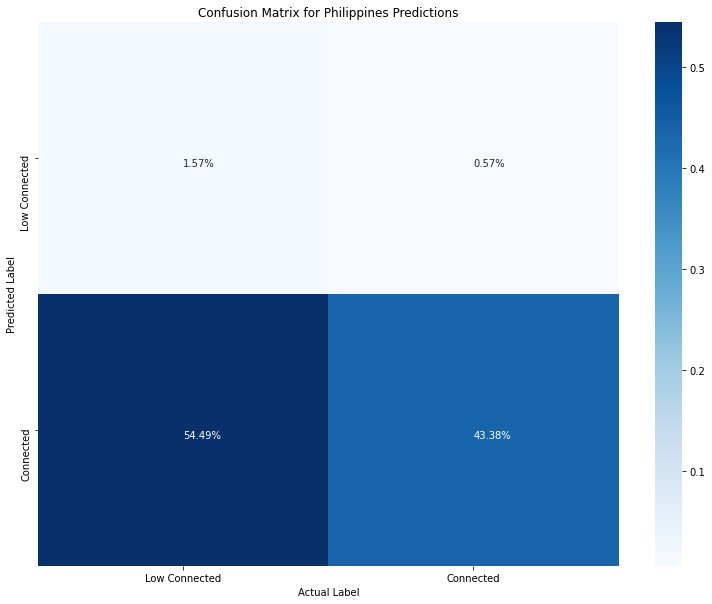

In [88]:
def plot_confusion(tp, tn, fp, fn, country_name):  
  conf_arr = np.array([[tp,fp],[fn,tn]])

  sum = conf_arr.sum()

  conf_arr = conf_arr * 100.0 / ( 1.0 * sum )

  df_cm = pd.DataFrame(conf_arr, 
    index = [ 'Low Connected', 'Connected'],
    columns = ['Low Connected', 'Connected'])

  fig ,ax = plt.subplots(figsize=(13,10))
  conf_plt = sns.heatmap(df_cm/100, annot=True, fmt='.2%', cmap='Blues', annot_kws={"ha": 'left',"va": 'top'});
  ax.set_ylim([0,2]);
  conf_plt.invert_yaxis()
  ax.title.set_text('Confusion Matrix for ' + country_name + ' Predictions')
  ax.set_ylabel('Predicted Label');
  ax.set_xlabel('Actual Label');

plot_confusion(tp_tha, tn_tha, fp_tha, fn_tha, 'Thailand')
plot_confusion(tp_phl, tn_phl, fp_phl, fn_phl, 'Philippines')

## Training a new model on Thailand and Philippines data with Brazil hyperparameters

In [89]:
model_tha = xgb.XGBRegressor(random_state=42, n_estimators=550, max_depth=9, eta=.2, n_jobs=16)
model_tha.fit(x_tha, y_tha)

model_phl = xgb.XGBRegressor(random_state=42, n_estimators=550, max_depth=9, eta=.2, n_jobs=16)
model_phl.fit(x_phl, y_phl)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eta=0.2, gamma=0,
             gpu_id=-1, importance_type='gain', interaction_constraints='',
             learning_rate=0.200000003, max_delta_step=0, max_depth=9,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=550, n_jobs=16, num_parallel_tree=1, random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

## Model Evaluation

In [90]:
t_exp_tha = dx.Explainer(model_tha, x_tha, y_tha, label='xGradient Boosting Thailand trained')
t_exp_phl = dx.Explainer(model_phl, x_phl, y_phl, label='xGradient Boosting Philippines trained')

Preparation of a new explainer is initiated

  -> data              : 4723 rows 12 cols
  -> target variable   : Parameter 'y' was a pandas.DataFrame. Converted to a numpy.ndarray.
  -> target variable   : 4723 values
  -> model_class       : xgboost.sklearn.XGBRegressor (default)
  -> label             : xGradient Boosting Thailand trained
  -> predict function  : <function yhat_default at 0x0000029D344FC168> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.491, mean = 0.706, max = 0.931
  -> model type        : regression will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.00671, mean = -4.87e-06, max = 0.00843
  -> model_info        : package xgboost

A new explainer has been created!
Preparation of a new explainer is initiated

  -> data              : 4599 rows 12 cols
  -> target variable   : Parameter 'y' was a pandas

## Permutation Feature Importance for Philippines

In [91]:
mfe_t_tha = t_exp_tha.model_parts()
mfe_t_phl = t_exp_phl.model_parts()

In [92]:
mfe_bra.plot()
mfe_t_tha.plot()
mfe_t_phl.plot()

## Residual Analysis

In [93]:
md_t_tha = t_exp_tha.model_diagnostics()
md_t_phl = t_exp_phl.model_diagnostics()
md_t_tha.plot(md_bra)
md_t_phl.plot(md_bra)

In [94]:
mp_t_tha = t_exp_tha.model_performance(model_type='regression')
mp_t_phl = t_exp_phl.model_performance(model_type='regression')
mp_t_tha.plot(mp_bra)

In [95]:
mp_t_phl.plot(mp_bra)

In [96]:
mp_t_tha.result

,mse,rmse,r2,mae,mad
xGradient Boosting Thailand trained,0.000002,0.001317,0.999764,0.000873,0.000543


In [97]:
mp_t_phl.result

,mse,rmse,r2,mae,mad
xGradient Boosting Philippines trained,0.000002,0.001493,0.999961,0.000975,0.000595


## Model Performance

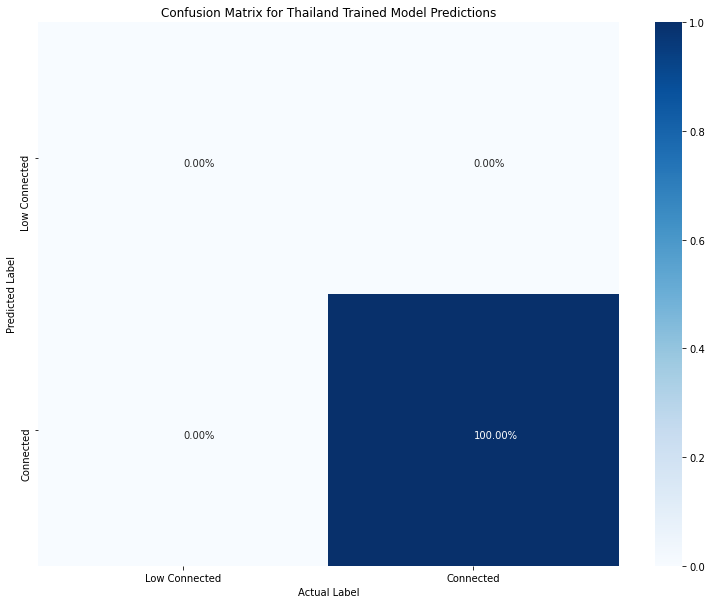

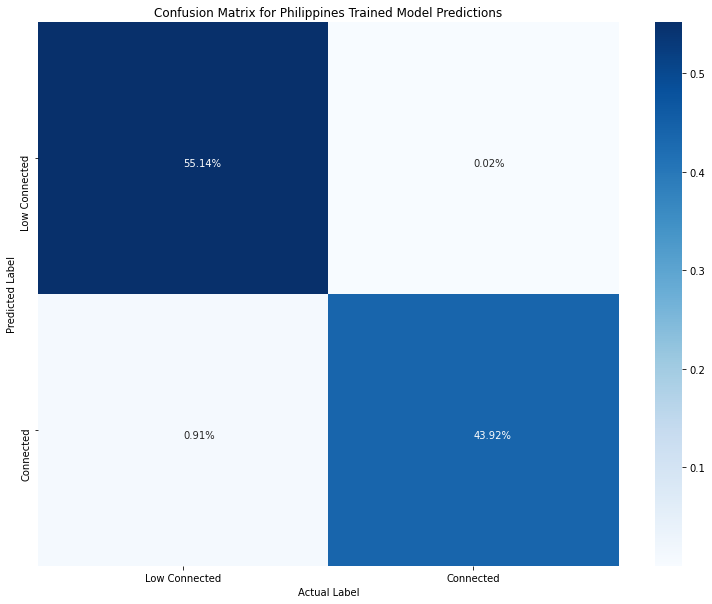

In [98]:
tp_t_tha = len(mp_t_tha.residuals[(mp_t_tha.residuals.y_hat<=ts) & (mp_t_tha.residuals.y<=ts)])
tn_t_tha = len(mp_t_tha.residuals[(mp_t_tha.residuals.y_hat>ts) & (mp_t_tha.residuals.y>ts)])
fp_t_tha = len(mp_t_tha.residuals[(mp_t_tha.residuals.y_hat<=ts) & (mp_t_tha.residuals.y>ts)])
fn_t_tha = len(mp_t_tha.residuals[(mp_t_tha.residuals.y_hat>ts) & (mp_t_tha.residuals.y<=ts)])

tp_t_phl = len(mp_t_phl.residuals[(mp_t_phl.residuals.y_hat<=ts) & (mp_t_phl.residuals.y<=ts)])
tn_t_phl = len(mp_t_phl.residuals[(mp_t_phl.residuals.y_hat>ts) & (mp_t_phl.residuals.y>ts)])
fp_t_phl = len(mp_t_phl.residuals[(mp_t_phl.residuals.y_hat<=ts) & (mp_t_phl.residuals.y>ts)])
fn_t_phl = len(mp_t_phl.residuals[(mp_t_phl.residuals.y_hat>ts) & (mp_t_phl.residuals.y<=ts)])

plot_confusion(tp_t_tha, tn_t_tha, fp_t_tha, fn_t_tha, 'Thailand Trained Model')
plot_confusion(tp_t_phl, tn_t_phl, fp_t_phl, fn_t_phl, 'Philippines Trained Model')

## Geo-Visuals

In [145]:
def plot_map(lat_arr, lon_arr, color_arr):
    fig = go.Figure(go.Scattermapbox(
            lat=lat_arr,
            lon=lon_arr,
            mode='markers+text',
            marker=go.scattermapbox.Marker(
                size=3, color= color_arr,
                showscale=True,
                colorscale=px.colors.diverging.RdYlGn,
                cmax=1,
                cmin=0,
            ),
            text=['Montreal'],
            hovertext=color_arr,
        ))

    fig.update_layout(
        hovermode='closest',
        mapbox=dict(
            accesstoken=mapbox_access_token,
            style='dark',
            center = {"lat": lat_arr.mean(), "lon": lon_arr.mean()},
            bearing=0,
            pitch=0,
            zoom=3.9,
        )
    )

    fig.show()

In [126]:
plot_map(data_tha.latitude, data_tha.longitude, mp_tha.residuals.y_hat)
plot_map(data_tha.latitude, data_tha.longitude, mp_t_tha.residuals.y_hat)
plot_map(data_tha.latitude, data_tha.longitude, mp_t_tha.residuals.y)

plot_map(data_phl.latitude, data_phl.longitude, mp_phl.residuals.y_hat)
plot_map(data_phl.latitude, data_phl.longitude, mp_t_phl.residuals.y_hat)
plot_map(data_phl.latitude, data_phl.longitude, mp_t_phl.residuals.y)

## Country aggregated prediction of proportion of connectivity around schools

These are the predictions that are made by Brazil trained model! Each school is given the weight of one, this is not the population scaled proportion!

In [149]:
print('Average of predictions of connected proportion for schools in Thailand by Brazil trained model: ' + str((mp_tha.residuals.y_hat).mean()))
print('Average of predictions of connected proportion for schools in Philippines by Brazil trained model: ' + str((mp_phl.residuals.y_hat).mean()))

Average of predictions of connected proportion for schools in Thailand by Brazil trained model: 0.5672079
Average of predictions of connected proportion for schools in Philippines by Brazil trained model: 0.6080036


## Country aggregated ground truth around schools

Each school is given the weight of one, this is not the population scaled proportion!

In [150]:
print('Average of ground truth for schools in Thailand: ' + str((mp_tha.residuals.y).mean()))
print('Average of ground truth for schools in Philippines: ' + str((mp_phl.residuals.y).mean()))

Average of ground truth for schools in Thailand: 0.7061349699383886
Average of ground truth for schools in Philippines: 0.29134710844377765
